# G2M Insight for Cab Investment Firm

**The Client**

XYZ is a private firm in US. Due to remarkable growth in the Cab Industry in last few years and multiple key players in the market, it is planning for an investment in Cab industry and as per their Go-to-Market(G2M) strategy they want to understand the market before taking final decision.


Time period of data is from **31/01/2016 to 31/12/2018**:


- **Cab_Data** – this file includes details of transaction for 2 cab companies

- **Customer_ID** – this is a mapping table that contains a unique identifier which links the customer’s demographic details

- **Transaction_ID** – this is a mapping table that contains transaction to customer mapping and payment mode

- **City** – this file contains list of US cities, their population and number of cab users

**Resources:**<br>
[G2M Strategy](https://blog.hubspot.com/sales/gtm-strategy)

In [77]:
import os
import sys
import pandas as pd
import numpy as np

# Visualizations
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight') 
%matplotlib inline
import plotly.graph_objects as go
import plotly.express as px
from pylab import rcParams
from plotly import tools
import plotly
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff

In [160]:
# Function to display plotly in jupyter notebook
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)

In [184]:
# Import the data by reeading multiple files
city = pd.read_csv('/Users/jasonrobinson/Desktop/cab_dataset/City.csv')
cab = pd.read_csv('/Users/jasonrobinson/Desktop/cab_dataset/Cab_Data.csv')
customer = pd.read_csv('/Users/jasonrobinson/Desktop/cab_dataset/Customer_ID.csv')
transaction = pd.read_csv('/Users/jasonrobinson/Desktop/cab_dataset/Transaction_ID.csv')

In [66]:
# Shape of our datasets pre-merged
print('\n', 'City:', city.shape, '\n', 'Cab:', cab.shape, '\n', 'Customer:', customer.shape,'\n', 'Transaction:', transaction.shape)


 City: (20, 3) 
 Cab: (359392, 7) 
 Customer: (49171, 4) 
 Transaction: (440098, 3)


### Master Dataframe

In [71]:
# Not sure how much data will be lost due to merging; however, there likely is enough data present to gather meaningful insights
#cab_data = cab.merge(transaction, on='Transaction ID').merge(customer, on='Customer ID').merge(city, on='City')
#print(cab_data.shape)
#cab_data.sample(5)

In [185]:
# After refactoring we now have all of our data
# wit the exception of City dataset
left = cab.set_index(['Transaction ID'])
right = transaction.set_index(['Transaction ID'])
cab_data = left.join(right)

left = cab_data.set_index([cab_data.index,'Customer ID'])
right = customer.set_index(['Customer ID'])
cab_data = left.join(right)

cab_data = cab_data.reset_index()
cab_data.head()

,Transaction ID,Customer ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Payment_Mode,Gender,Age,Income (USD/Month)
0,10000011,29290,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635,Card,Male,28,10813
1,10000012,27703,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854,Card,Male,27,9237
2,10000013,28712,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632,Cash,Male,53,11242
3,10000014,28020,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602,Cash,Male,23,23327
4,10000015,27182,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776,Card,Male,33,8536


In [193]:
city

,City,Population,Users
0,NEW YORK NY,"8,405,837","302,149"
1,CHICAGO IL,"1,955,130","164,468"
2,LOS ANGELES CA,"1,595,037","144,132"
3,MIAMI FL,"1,339,155","17,675"
4,SILICON VALLEY,"1,177,609","27,247"
5,ORANGE COUNTY,"1,030,185","12,994"
6,SAN DIEGO CA,"959,307","69,995"
7,PHOENIX AZ,"943,999","6,133"
8,DALLAS TX,"942,908","22,157"
9,ATLANTA GA,"814,885","24,701"


In [186]:
# Rename columns
cab_data.rename(columns={'Transaction ID':'transact_id', 
                        'Date of Travel':'Date of Travel',
                        'Company':'company',
                        'City':'city', 
                        'KM Travelled':'km_traveled',
                        'Price Charged':'price_charged',
                        'Cost of Trip':'trip_cost',
                        'Customer ID':'customer_id', 
                        'Gender':'gender',
                        'Age':'age',
                        'Income (USD/Month)':'monthly_income',
                        'Transaction ID':'transact_id', 
                        'Customer ID':'cust_id',
                        'Payment_Mode':'pay_method',
                        'City':'city', 
                        'Population':'population',
                        'Users':'users'}, inplace=True)

cab_data.sample(2)

,transact_id,cust_id,Date of Travel,company,city,km_traveled,price_charged,trip_cost,pay_method,gender,age,monthly_income
146071,10180060,5523,42889,Yellow Cab,CHICAGO IL,19.00,295.53,230.2800,Card,Male,35,9888
46701,10059034,53880,42580,Yellow Cab,WASHINGTON DC,8.56,117.10,120.1824,Cash,Male,43,12774


### Preprocessing

In [188]:
"""Cab and Transaction share ID"""
# Convert date of travel string into datetime providing our 
# timestep function for begin

begin = pd.Timestamp('1900-1-28')

cab_data["travel_date"] = pd.to_datetime(cab_data["Date of Travel"], unit="D", origin=begin)
cab_data = cab_data.drop('Date of Travel', axis=1)

cab_data.head()

,transact_id,cust_id,company,city,km_traveled,price_charged,trip_cost,pay_method,gender,age,monthly_income,travel_date
0,10000011,29290,Pink Cab,ATLANTA GA,30.45,370.95,313.635,Card,Male,28,10813,2016-02-06
1,10000012,27703,Pink Cab,ATLANTA GA,28.62,358.52,334.854,Card,Male,27,9237,2016-02-04
2,10000013,28712,Pink Cab,ATLANTA GA,9.04,125.20,97.632,Cash,Male,53,11242,2016-01-31
3,10000014,28020,Pink Cab,ATLANTA GA,33.17,377.40,351.602,Cash,Male,23,23327,2016-02-05
4,10000015,27182,Pink Cab,ATLANTA GA,8.73,114.62,97.776,Card,Male,33,8536,2016-02-01


Filter our date column to the range given  **31/01/2016 to 31/12/2018**. 

In [189]:
# Filter to 31/01/2016 to 31/12/2018
cab_data = cab_data[cab_data['travel_date'] < '2019-1-1']
cab_data['travel_date'].sort_values()

858      2016-01-31
636      2016-01-31
993      2016-01-31
339      2016-01-31
152      2016-01-31
            ...    
342031   2018-12-31
340345   2018-12-31
342035   2018-12-31
342456   2018-12-31
339806   2018-12-31
Name: travel_date, Length: 344953, dtype: datetime64[ns]

We see that our cab_yellow dataset is significantly larger than our pink dataset, **3 times larger**, thus we must take that into consideration when conducting comparison measures.

In [195]:
# Create a dataset for each company
cab_yellow = cab_data[cab_data['company'] == 'Yellow Cab']
cab_pink = cab_data[cab_data['company'] == 'Pink Cab']
print(f'Shape of the Yellow Cab Company:', cab_yellow.shape)
print(f'Shape of the Pink Cab Company:', cab_pink.shape)

Shape of the Yellow Cab Company: (263739, 12)
Shape of the Pink Cab Company: (81214, 12)


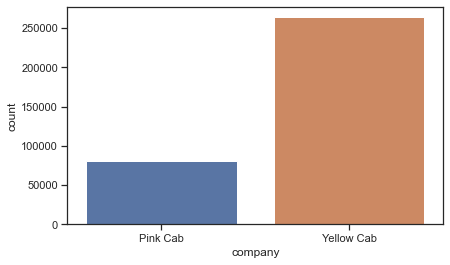

In [196]:
sns.countplot(x='company', data=cab_data)
plt.show()

In [17]:
# Summary statistics cab_pink
cab_pink.describe()

,transact_id,Date of Travel,km_traveled,price_charged,trip_cost,cust_id,age,monthly_income
count,8.121400e+04,81214.000000,81214.000000,81214.000000,81214.000000,81214.000000,81214.000000,81214.000000
mean,1.021522e+07,42954.697761,22.566319,310.343039,248.209825,18434.496528,35.326988,15063.937979
std,1.215152e+05,295.265550,12.240539,181.993569,135.494330,18064.060141,12.654420,7989.783192
min,1.000001e+07,42371.000000,1.900000,15.600000,19.000000,1.000000,18.000000,2000.000000
25%,1.010617e+07,42693.000000,12.000000,159.530000,131.824000,5365.000000,25.000000,8371.000000
50%,1.021842e+07,42984.000000,22.440000,297.555000,246.330000,8884.500000,33.000000,14715.000000
75%,1.032216e+07,43203.000000,32.980000,440.660000,360.360000,27183.000000,42.000000,21065.000000
max,1.043762e+07,43436.000000,48.000000,1623.480000,576.000000,60000.000000,65.000000,35000.000000


In [18]:
# Summary statistics cab_yellow
cab_yellow.describe()

,transact_id,Date of Travel,km_traveled,price_charged,trip_cost,cust_id,age,monthly_income
count,2.637390e+05,263739.000000,263739.000000,263739.000000,263739.000000,263739.000000,263739.000000,263739.000000
mean,1.021112e+07,42940.293370,22.570987,459.263034,297.942929,19489.011136,35.341868,15044.953674
std,1.221050e+05,297.318706,12.230301,289.185835,162.503547,21850.956437,12.581158,7962.302754
min,1.000038e+07,42371.000000,1.900000,20.730000,22.800000,1.000000,18.000000,2000.000000
25%,1.010671e+07,42687.000000,12.000000,227.270000,158.508000,2419.000000,25.000000,8443.000000
50%,1.021052e+07,42965.000000,22.440000,425.900000,295.596000,6481.000000,33.000000,14675.000000
75%,1.031633e+07,43183.000000,32.960000,635.580000,432.432000,39356.000000,42.000000,21022.000000
max,1.044011e+07,43436.000000,48.000000,2048.030000,691.200000,60000.000000,65.000000,34996.000000


In [213]:
def summary_stats(cab_data):
    print(f'Summary Statistics for the {cab_data.company} Company:')
    print(cab_data.describe())
    return cab_data


cab_new = pd.DataFrame(summary_stats(cab_yellow), summary_stats(cab_pink))
cab_new.T


Summary Statistics for the 233       Yellow Cab
234       Yellow Cab
235       Yellow Cab
236       Yellow Cab
237       Yellow Cab
             ...    
359387    Yellow Cab
359388    Yellow Cab
359389    Yellow Cab
359390    Yellow Cab
359391    Yellow Cab
Name: company, Length: 263739, dtype: object Company:
        transact_id        cust_id    km_traveled  price_charged  \
count  2.637390e+05  263739.000000  263739.000000  263739.000000   
mean   1.021112e+07   19489.011136      22.570987     459.263034   
std    1.221050e+05   21850.956437      12.230301     289.185835   
min    1.000038e+07       1.000000       1.900000      20.730000   
25%    1.010671e+07    2419.000000      12.000000     227.270000   
50%    1.021052e+07    6481.000000      22.440000     425.900000   
75%    1.031633e+07   39356.000000      32.960000     635.580000   
max    1.044011e+07   60000.000000      48.000000    2048.030000   

           trip_cost            age  monthly_income  
count  263739.000000 

,"(10000011, 29290, Pink Cab, ATLANTA GA, 30.45, 370.95, 313.635, Card, Male, 28, 10813, 2016-02-06 00:00:00)","(10000012, 27703, Pink Cab, ATLANTA GA, 28.62, 358.52, 334.85400000000004, Card, Male, 27, 9237, 2016-02-04 00:00:00)","(10000013, 28712, Pink Cab, ATLANTA GA, 9.04, 125.2, 97.632, Cash, Male, 53, 11242, 2016-01-31 00:00:00)","(10000014, 28020, Pink Cab, ATLANTA GA, 33.17, 377.4, 351.602, Cash, Male, 23, 23327, 2016-02-05 00:00:00)","(10000015, 27182, Pink Cab, ATLANTA GA, 8.73, 114.62, 97.77600000000001, Card, Male, 33, 8536, 2016-02-01 00:00:00)","(10000016, 27318, Pink Cab, ATLANTA GA, 6.06, 72.43, 63.023999999999994, Cash, Male, 25, 13984, 2016-02-05 00:00:00)","(10000017, 33788, Pink Cab, AUSTIN TX, 44.0, 576.15, 475.2, Card, Male, 23, 23788, 2016-02-01 00:00:00)","(10000018, 34106, Pink Cab, AUSTIN TX, 35.65, 466.1, 377.89, Card, Male, 19, 19980, 2016-02-05 00:00:00)","(10000019, 59799, Pink Cab, BOSTON MA, 14.4, 191.61, 146.88, Cash, Male, 33, 19271, 2016-02-10 00:00:00)","(10000020, 57982, Pink Cab, BOSTON MA, 10.89, 156.98, 113.256, Cash, Male, 57, 5068, 2016-02-04 00:00:00)",...,"(10437603, 53830, Pink Cab, WASHINGTON DC, 31.05, 403.24, 335.34, Card, Male, 18, 22979, 2018-02-03 00:00:00)","(10437604, 53622, Pink Cab, WASHINGTON DC, 30.9, 431.5, 349.17, Card, Male, 32, 20971, 2018-02-01 00:00:00)","(10437606, 51047, Pink Cab, WASHINGTON DC, 9.2, 124.97, 98.44, Card, Male, 21, 20141, 2018-02-02 00:00:00)","(10437607, 53095, Pink Cab, WASHINGTON DC, 17.85, 237.93, 182.07, Cash, Male, 19, 7338, 2018-02-02 00:00:00)","(10437608, 52086, Pink Cab, WASHINGTON DC, 21.4, 271.94, 235.4, Card, Female, 52, 23530, 2018-02-03 00:00:00)","(10437609, 51817, Pink Cab, WASHINGTON DC, 34.98, 461.83, 416.26199999999994, Card, Male, 22, 6397, 2018-02-07 00:00:00)","(10437610, 51142, Pink Cab, WASHINGTON DC, 13.56, 184.19, 135.6, Card, Female, 40, 3122, 2018-02-04 00:00:00)","(10437612, 53039, Pink Cab, WASHINGTON DC, 28.5, 369.04, 310.65, Card, Male, 37, 22765, 2018-02-05 00:00:00)","(10437614, 51766, Pink Cab, WASHINGTON DC, 16.1, 194.17, 162.61, Cash, Male, 18, 12364, 2018-01-31 00:00:00)","(10437615, 51996, Pink Cab, WASHINGTON DC, 22.2, 287.46, 244.2, Cash, Male, 36, 12905, 2018-02-03 00:00:00)"
transact_id,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
cust_id,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
company,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
city,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
km_traveled,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
price_charged,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
trip_cost,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
pay_method,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
gender,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
age,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT


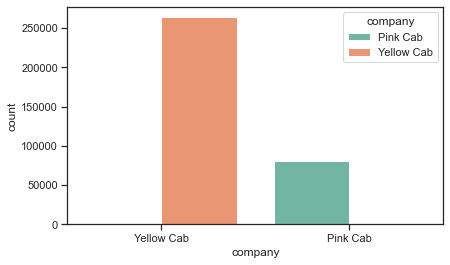

In [207]:
sns.countplot(x='company', 
              data=cab_data, 
              palette='Set2', 
              order=['Yellow Cab', 'Pink Cab'],
              hue='company');

### All must be ran before here.

### Build on creating statistical analysis - answer business questions.

Perform analysis and provide visualizations to gather further insights and recommendations for the next steps in the process of determing optimal investment following the G2M strategy.
        

In [163]:
#print(f'Mean Age:-----------------------',cab_data.describe().at['mean', 'age'])
#print(f'Standard Deviation Age:---------',cab_data.describe().at['std', 'age'])
#print(f'Age within the (25th%):---------',cab_data.describe().at['25%', 'age'])
#print(f'Age within the (50th%):---------',cab_data.describe().at['50%', 'age'])
#print(f'Age within the (75th%):---------',cab_data.describe().at['75%', 'age'])

In [21]:
# Print out index and mean and std columns in a dataframe
#for col in cab_data.columns[0]:
#        if col != 'transact_id' and col != 'customer_id' and col != 'travel_date':
#            print(col, cab_data[col].mean(), cab_data[col].std())

In [22]:
print(f'Mean Age:-----------------------',cab_data.describe().at['mean','age'])
print(f'Standard Deviation Age:---------',cab_data.describe().at['std', 'age'])
print(f'Age within the (25th%):---------',cab_data.describe().at['25%', 'age'])
print(f'Age within the (50th%):---------',cab_data.describe().at['50%', 'age'])
print(f'Age within the (75th%):---------',cab_data.describe().at['75%', 'age'])

Mean Age:----------------------- 35.338364936672534
Standard Deviation Age:--------- 12.598427624775667
Age within the (25th%):--------- 25.0
Age within the (50th%):--------- 33.0
Age within the (75th%):--------- 42.0


In [219]:
print(f'Mean Price_Charged:-----------------------',cab_data.describe().at['mean','price_charged'])
print(f'Standard Deviation Price_Charged:---------',cab_data.describe().at['std', 'price_charged'])
print(f'Price_charged within the (25th%):---------',cab_data.describe().at['25%', 'price_charged'])
print(f'Price_charged within the (50th%):---------',cab_data.describe().at['50%', 'price_charged'])
print(f'Price_charged within the (75th%):---------',cab_data.describe().at['75%', 'price_charged'])

Mean Price_Charged:----------------------- 424.2020590341293
Standard Deviation Price_Charged:--------- 275.18952089114737
Price_charged within the (25th%):--------- 206.79
Price_charged within the (50th%):--------- 386.81
Price_charged within the (75th%):--------- 584.74


In [216]:
print(f'Mean KM_Traveled:-----------------------',cab_data.describe().at['mean','km_traveled'])
print(f'Standard Deviation KM_Traveled:---------',cab_data.describe().at['std', 'km_traveled'])
print(f'KM_Traveled within the (25th%):---------',cab_data.describe().at['25%', 'km_traveled'])
print(f'KM_Traveled within the (50th%):---------',cab_data.describe().at['50%', 'km_traveled'])
print(f'KM_Traveled within the (75th%):---------',cab_data.describe().at['75%', 'km_traveled'])

Mean KM_Traveled:----------------------- 22.56988757888756
Standard Deviation KM_Traveled:--------- 12.232694674157651
KM_Traveled within the (25th%):--------- 12.0
KM_Traveled within the (50th%):--------- 22.44
KM_Traveled within the (75th%):--------- 32.96


In [217]:
print(f'Mean Trip_Cost:-----------------------',cab_data.describe().at['mean','trip_cost'])
print(f'Standard Deviation Trip_Cost:---------',cab_data.describe().at['std', 'trip_cost'])
print(f'Trip_Cost within the (25th%):---------',cab_data.describe().at['25%', 'trip_cost'])
print(f'Trip_Cost within the (50th%):---------',cab_data.describe().at['50%', 'trip_cost'])
print(f'Trip_Cost within the (75th%):---------',cab_data.describe().at['75%', 'trip_cost'])

Mean Trip_Cost:----------------------- 286.23401725858315
Standard Deviation Trip_Cost:--------- 157.97982262821932
Trip_Cost within the (25th%):--------- 151.2576
Trip_Cost within the (50th%):--------- 282.492
Trip_Cost within the (75th%):--------- 413.751


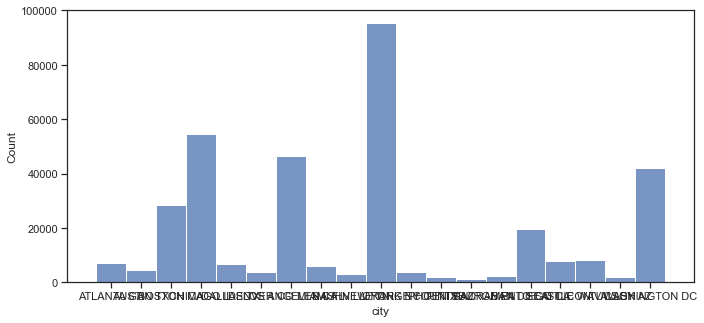

In [255]:
# Which company has maximum cab users at a particular time period?
fig, ax = plt.subplots(figsize=(10,5))
sns.histplot(cab_data['city'],
            palette='Set1',
            ax=ax)
plt.show()

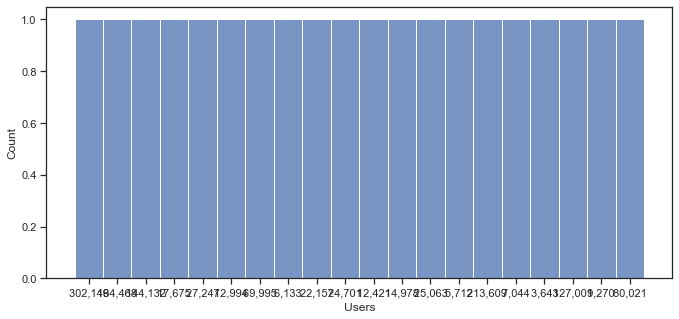

In [252]:
fig, ax = plt.subplots(figsize=(10,5))
sns.histplot(city['Users'],
            palette='Set1',
            ax=ax)
plt.show()

In [253]:
cab_data['travel_date'] = pd.to_datetime(cab_data['travel_date'])
cab_data = cab_data.set_index('travel_date')

In [254]:
cab_data

,transact_id,cust_id,company,city,km_traveled,price_charged,trip_cost,pay_method,gender,age,monthly_income
travel_date,,,,,,,,,,,
2016-02-06,10000011,29290,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,Card,Male,28,10813
2016-02-04,10000012,27703,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,Card,Male,27,9237
2016-01-31,10000013,28712,Pink Cab,ATLANTA GA,9.04,125.20,97.6320,Cash,Male,53,11242
2016-02-05,10000014,28020,Pink Cab,ATLANTA GA,33.17,377.40,351.6020,Cash,Male,23,23327
2016-02-01,10000015,27182,Pink Cab,ATLANTA GA,8.73,114.62,97.7760,Card,Male,33,8536
...,...,...,...,...,...,...,...,...,...,...,...
2018-02-06,10440101,52392,Yellow Cab,WASHINGTON DC,4.80,69.24,63.3600,Cash,Male,24,15651
2018-02-02,10440104,53286,Yellow Cab,WASHINGTON DC,8.40,113.75,106.8480,Cash,Male,32,6528
2018-02-03,10440105,52265,Yellow Cab,WASHINGTON DC,27.75,437.07,349.6500,Cash,Male,56,7966


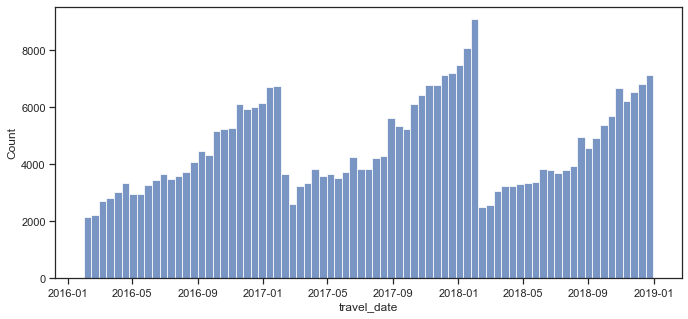

In [257]:
fig, ax = plt.subplots(figsize=(10,5))
sns.histplot(cab_data.index,
            palette='Set1',
            ax=ax)
plt.show()

This one did kind of shocked me, a clear pattern of seasonality, with annual highs consistently for the time range, which helps us better predict future activity.

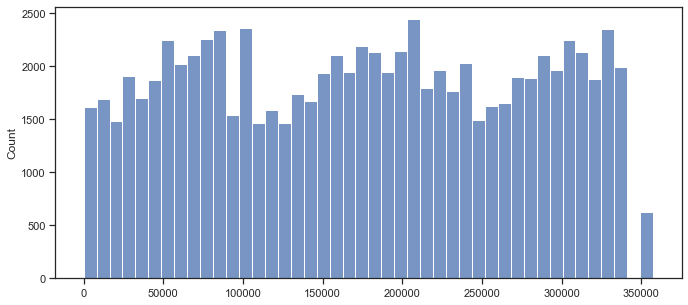

In [263]:
fig, ax = plt.subplots(figsize=(10,5))
sns.histplot(cab_pink.index,
            palette='Set1',
            ax=ax)
plt.show()

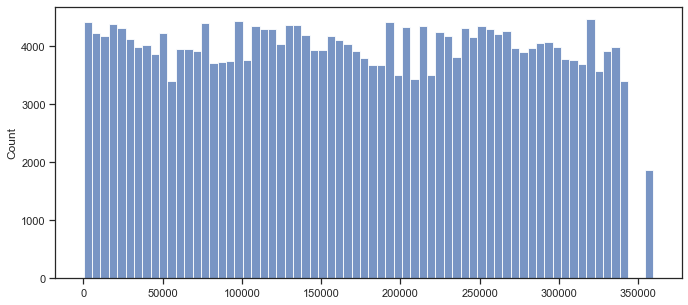

In [262]:
fig, ax = plt.subplots(figsize=(10,5))
sns.histplot(cab_yellow.index,
            palette='Set1',
            ax=ax)
plt.show()

### Visualizations

Although the two companies are different in volume of users, the distributions are very similar.

In [258]:
cab_yellow['users'].hist();

KeyError: 'users'

In [259]:
cab_pink['users'].hist();

KeyError: 'users'

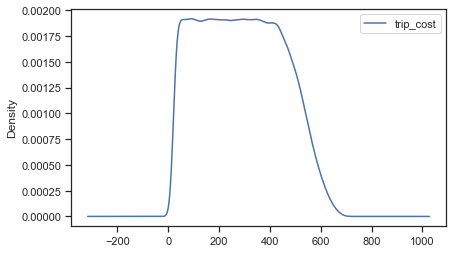

In [260]:
cab_data[['trip_cost']].plot(kind='density');

In [170]:
cab_data.columns

Index(['transact_id', 'cust_id', 'company', 'city', 'km_traveled',
       'price_charged', 'trip_cost', 'pay_method', 'gender', 'age',
       'monthly_income', 'travel_date'],
      dtype='object')

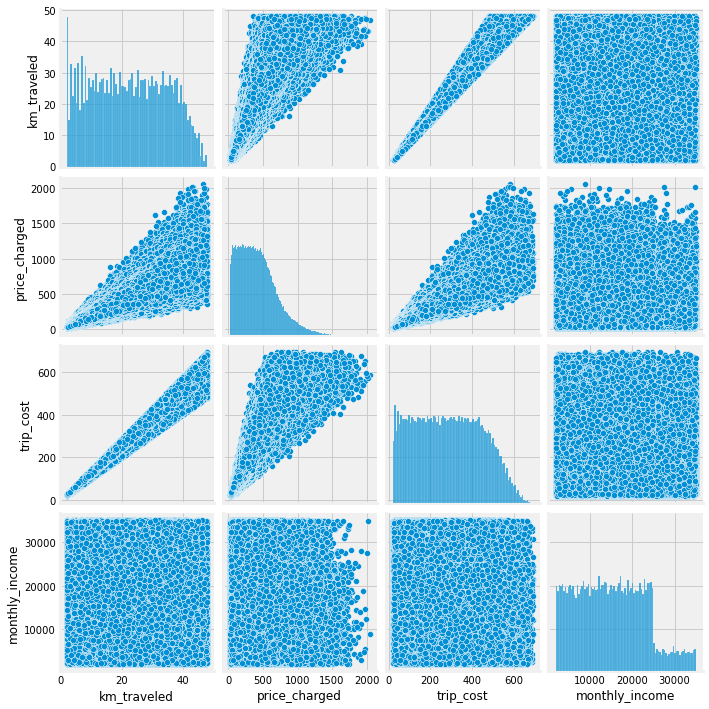

In [124]:
cab_data_sub = sns.pairplot(cab_data[['km_traveled', 'price_charged', 'trip_cost', 'monthly_income']])

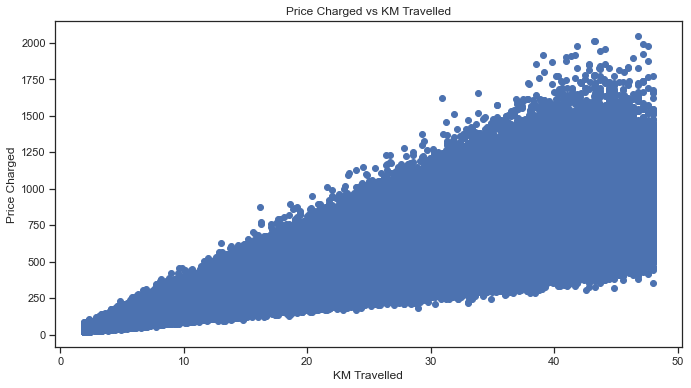

In [179]:
fig, ax = plt.subplots(figsize=(10,6))
ax.scatter(cab_data['km_traveled'], cab_data['price_charged'])
ax.set_xlabel('KM Travelled')
ax.set_ylabel('Price Charged')
ax.set_title('Price Charged vs KM Travelled')
plt.show()

In [180]:
import plotly.graph_objects as go
import plotly.express as px

px = px.scatter(cab_data, x="city", y="company", color="trip_cost", size="trip_cost")
px.show()

### Correlation comparison

In [133]:
# Applying the pearson method for correlations
cab_yellow_corr = cab_yellow[['km_traveled', 'price_charged', 'trip_cost', 'monthly_income', 'age', 'Date of Travel']].corr(method='pearson')
cab_yellow_corr

,km_traveled,price_charged,trip_cost,monthly_income,age,Date of Travel
km_traveled,1.000000,0.859181,0.993384,-0.001254,-0.000052,-0.002883
price_charged,0.859181,1.000000,0.853455,0.003407,-0.003383,-0.057483
trip_cost,0.993384,0.853455,1.000000,-0.001158,0.000104,-0.003124
monthly_income,-0.001254,0.003407,-0.001158,1.000000,0.001977,-0.000191
age,-0.000052,-0.003383,0.000104,0.001977,1.000000,-0.001011
Date of Travel,-0.002883,-0.057483,-0.003124,-0.000191,-0.001011,1.000000


In [134]:
cab_pink_corr = cab_pink[['km_traveled', 'price_charged', 'trip_cost', 'monthly_income', 'age', 'Date of Travel']].corr(method='pearson')
cab_pink_corr

,km_traveled,price_charged,trip_cost,monthly_income,age,Date of Travel
km_traveled,1.000000,0.926892,0.993377,-0.000032,-0.005392,0.003499
price_charged,0.926892,1.000000,0.921087,0.001684,-0.007227,-0.026538
trip_cost,0.993377,0.921087,1.000000,-0.000215,-0.006124,0.004159
monthly_income,-0.000032,0.001684,-0.000215,1.000000,0.009852,-0.005215
age,-0.005392,-0.007227,-0.006124,0.009852,1.000000,-0.001820
Date of Travel,0.003499,-0.026538,0.004159,-0.005215,-0.001820,1.000000


In [183]:
cab_data_corr = cab_data[['km_traveled', 'price_charged', 'trip_cost', 'monthly_income', 'age', 'travel_date']].corr(method='pearson')
cab_data_corr

KeyError: "['travel_date'] not in index"

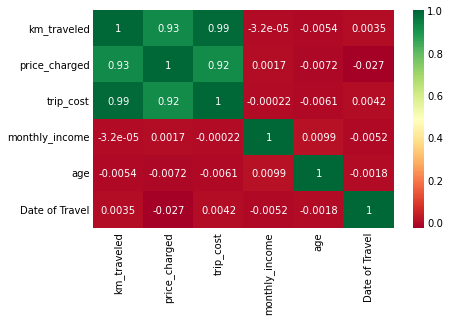

In [135]:
# Create a heatmap that will show the correlation between the variables for two datasets
sns.heatmap(cab_pink_corr, annot=True, cmap='RdYlGn')
plt.show()

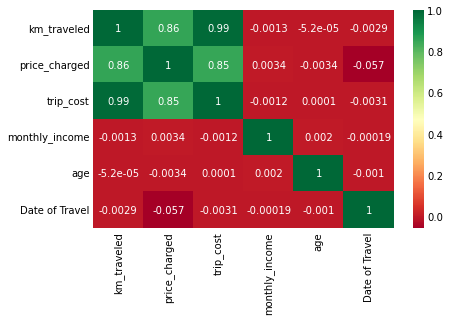

In [136]:
sns.heatmap(cab_yellow_corr, annot=True, cmap='RdYlGn')
plt.show()

In [ ]:
sns.heatmap(cab_yellow_corr, annot=True, cmap='RdYlGn')
plt.show()

What we can determine from our measures and visuals from our Heatmap that distance or kilometers travelled is highly correlated with the cost of the trip and the price charged for the actual trip, and as such trip cost and price charged have a high level of correlation.

Further analysis will support this hypothesis as well.

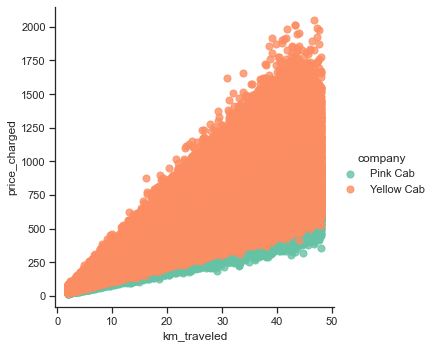

In [265]:
sns.lmplot(x='km_traveled',
              y='price_charged',
                data=cab_data,
                fit_reg=False,
                hue='company',
                palette='Set2',
                scatter_kws={'s': 50})
plt.show()

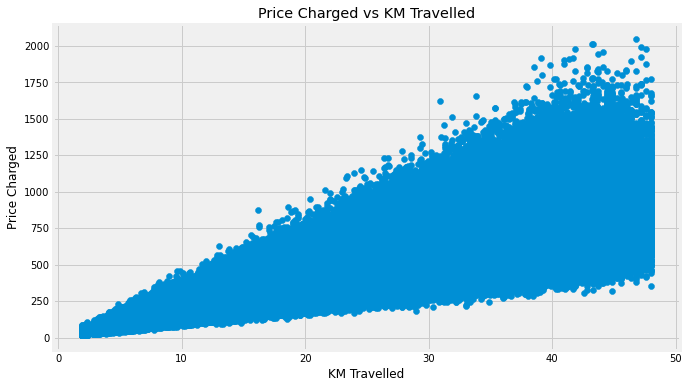

In [138]:
# Is there a relation between the price charged and the km travelled?
def price_vs_km():
    """
    Method:
        Plot the price charged vs km travelled
    """
    plt.figure(figsize=(10,6))
    plt.scatter(cab_data['km_traveled'], cab_data['price_charged'])
    plt.xlabel('KM Travelled')
    plt.ylabel('Price Charged')
    plt.title('Price Charged vs KM Travelled')
    plt.show()
    return


price_vs_km()

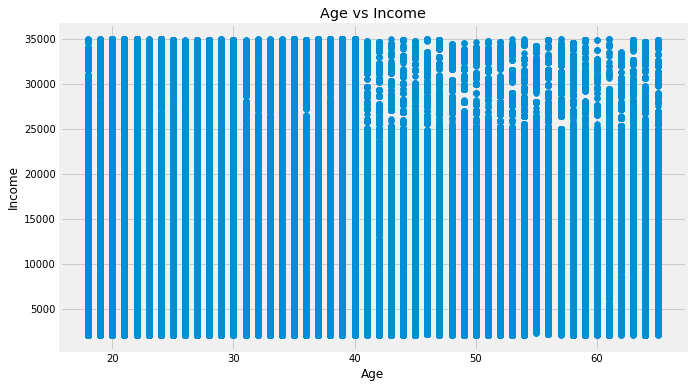

In [139]:
# Is there a relation between age and income?
def age_vs_income():
    """
    Method:
        Plot the age vs income
    """
    plt.figure(figsize=(10,6))
    plt.scatter(cab_data['age'], cab_data['monthly_income'])
    plt.xlabel('Age')
    plt.ylabel('Income')
    plt.title('Age vs Income')
    plt.show()
    return

age_vs_income()

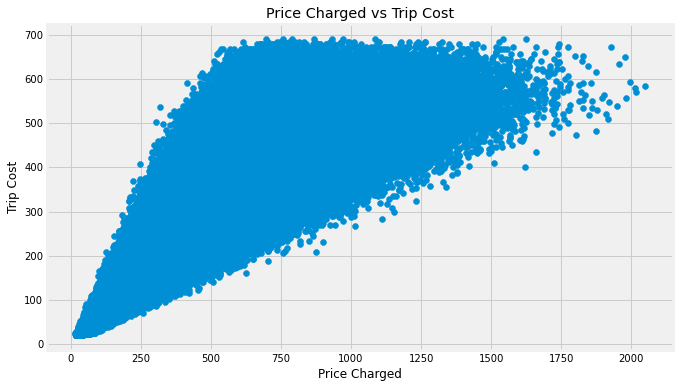

In [140]:
# What is the variance of price charged and trip cost?
def price_vs_trip_cost():
    """
    Method:
        Plot the price charged vs trip cost
    """
    plt.figure(figsize=(10,6))
    plt.scatter(cab_data['price_charged'], cab_data['trip_cost'])
    plt.xlabel('Price Charged')
    plt.ylabel('Trip Cost')
    plt.title('Price Charged vs Trip Cost')
    plt.show()
    return

price_vs_trip_cost()

In [144]:
# Relation between the number of users and the city?
def users_vs_city():
    """
    Method:
        Plot the number of users vs city
    """
    plt.figure(figsize=(10,6))
    plt.scatter(cab_data['city'], cab_data['users'])
    plt.xlabel('City')
    plt.ylabel('Users')
    plt.title('Users vs City')
    plt.show()
    return

users_vs_city()

KeyError: 'users'

<Figure size 1080x720 with 0 Axes>

In [145]:
# Relation between travel date and trip cost?
def travel_date_vs_trip_cost():
    """
    Method:
        Plot the travel date vs trip cost
    """
    plt.figure(figsize=(10,6))
    plt.scatter(cab_data['travel_date'], cab_data['trip_cost'])
    plt.xlabel('Travel Date')
    plt.ylabel('Trip Cost')
    plt.title('Travel Date vs Trip Cost')
    plt.show()
    return

# Statistical Analysis

In [53]:
# Correlation of all features 
def correlation_all():
    """
    Method:
        Correlation of all features
    """
    corr = cab_data.corr()
    sns.heatmap(corr, annot=True)
    plt.show()
    return

In [54]:
# Place the above function in a list to loop through    
plot_list = [price_vs_km, age_vs_income, price_vs_trip_cost, users_vs_city, travel_date_vs_trip_cost, correlation_all]

# Iterate through the list and plot the functions
def plot_relations(plot_list):
    for func in plot_list:
        func()
    return



plot_relations(plot_list)

TypeError: 'function' object is not subscriptable

<Figure size 720x432 with 0 Axes>

In [55]:
# Distribution of price charged
def distribution_all():
    """
    Method:
        Distribution of all features
    """
    plt.figure(figsize=(10,6))
    plt.hist(cab_data['price_charged'], bins=50)
    plt.xlabel('Price Charged')
    plt.ylabel('Frequency')
    plt.title('Price Charged Distribution')
    plt.show()
    return

In [31]:
# Which cab company has the highest number of users?
def highest_users():
    """
    Method:
        Which cab company has the highest number of users?
    """
    cab_data.groupby('company').users.max()
    return

In [32]:
#Which cab company has the higher price charged per km?
def highest_price_charged():
    """
    Method:
        Which cab company has the higher price charged per km?
    """
    cab_data.groupby('company').price_charged.max()
    return 

Let's get a general statistical analysis of the data.

In [33]:
plot_list = [price_vs_km, age_vs_income, price_vs_trip_cost, users_vs_city, travel_date_vs_trip_cost, correlation_all]

# Iterate through the list and plot the functions
def plot_relations(plot_list):
    """ 
    Method: 
        Iterate through the list and plot the functions
    """
    for func in plot_list:
        func()
    return


plot_relations(plot_list)

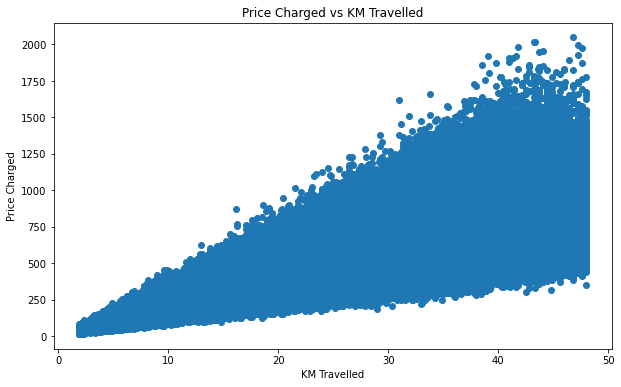

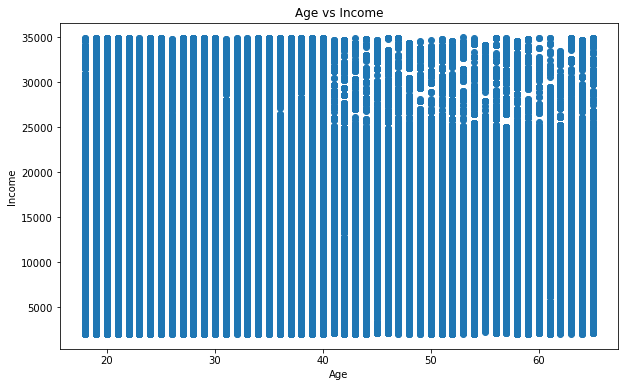

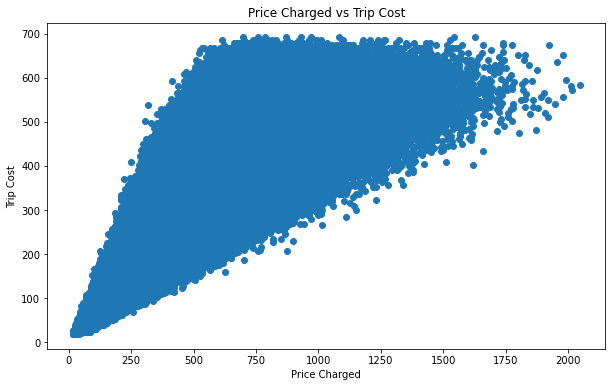

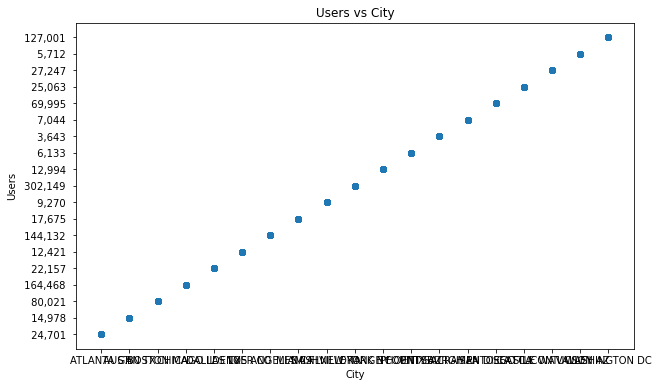

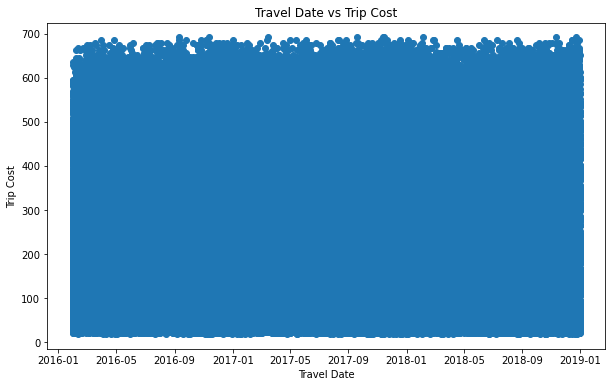

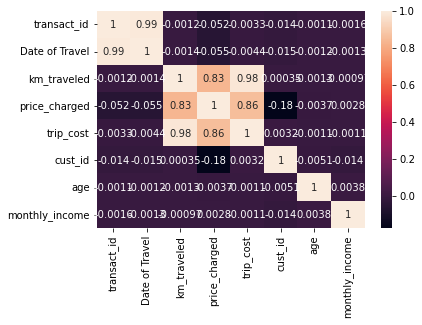

In [34]:
# Creat a class to contain all the functions
class Data_Analysis():
    """
    Class:
        Data_Analysis of all the functions related to relations between features
    """

    def __init__(self, cab_data):
        self.cab_data = cab_data
        return
    

    def price_km(self):
        """
        Method:
            Plot the price charged per km travelled
        """
        # We will need to determine the mean and standard deviation of the price charged per km travelled
        price_carried_per_km = (self.cab_data['price_charged'] / self.cab_data['km_traveled']) 
        plt.figure(figsize=(10,6))
        plt.scatter(self.cab_data['km_traveled'], price_carried_per_km)
        plt.xlabel('KM Travelled')
        plt.ylabel('Price Charged per KM')
        plt.title('Price Charged per KM vs KM Travelled')
        plt.show()
        return


    def age_vs_income(self):
        """
        Method:
            Plot the age vs income
        """
        plt.figure(figsize=(10,6))
        plt.scatter(self.cab_data['age'], self.cab_data['monthly_income'])
        plt.xlabel('Age')
        plt.ylabel('Income')
        plt.title('Age vs Income')
        plt.show()
        return
    

    def price_vs_trip_cost(self):
        """
        Method:
            Plot the price charged vs trip cost
        """
        plt.figure(figsize=(10,6))
        plt.scatter(self.cab_data['price_charged'], self.cab_data['trip_cost'])
        plt.xlabel('Price Charged')
        plt.ylabel('Trip Cost')
        plt.title('Price Charged vs Trip Cost')
        plt.show()
        return
    

    def price_vs_age(self):
        """
        Method:
            Plot the price charged vs age
        """
        plt.figure(figsize=(10,6))
        plt.scatter(self.cab_data['age'], self.cab_data['price_charged'])
        plt.xlabel('Age')
        plt.ylabel('Price Charged')
        plt.title('Price Charged vs Age')
        plt.show()
        return


    def travel_date_vs_trip_cost(self):
        """
        Method:
            Plot the travel date vs trip cost
        """
        fig, ax = plt.subplots(figsize=(7,5))
        ax.scatter(cab_data['travel_date'].dt.month, cab_data['trip_cost'])
        ax.set_xlabel('Travel Date', fontsize=12, fontweight='bold', color='black', labelpad=10) 
        ax.set_ylabel('Trip Cost', fontsize=12, fontweight='bold', color='black', labelpad=10)
        ax.set_title('Travel Date vs Trip Cost', fontsize=14, fontweight='bold', color='black', pad=10)
        plt.show()
        return


    def travel_date_vs_trip_cost(self):
        """
        Method:
            Plot the travel date vs trip cost
        """
        fig, ax = plt.subplots(figsize=(10,6))
        ax.hist(self.cab_data['price_charged'], bins=50)
        ax.set_xlabel('Price Charged')
        ax.set_ylabel('Frequency')
        ax.set_title('Price Charged Distribution')
        plt.show()
        return


    def correlation_all(self):
        """
        Method:
            Correlation of all features
        """
        corr = self.cab_data.corr()
        sns.heatmap(corr, annot=True)
        plt.show()
        return


    def distribution_all(self):
        """
        Method:
            Distribution of all features
        """
        plt.figure(figsize=(10,6))
        plt.hist(self.cab_data['price_charged'], bins=50)
        plt.xlabel('Price Charged')
        plt.ylabel('Frequency')
        plt.title('Price Charged Distribution')
        plt.show()
        return


    def plot_relations(self, plot_list):
        """
        Method:
            Iterate through the list and plot the functions
        """
        for func in plot_list:
            func()
        return



plot_relations(plot_list)

In [36]:
    
class UserMaxHighest(Data_Analysis):

    def __init__(self, cab_data):
        super().__init__(cab_data)
        return
        
    def highest_users(self):
        """
        Method:
            Which cab company has the highest number of users?
        """
        self.cab_data.groupby('company').users.max()
        return


    def highest_price_charged(self):
        """
        Method:
            Which cab company has the higher price charged per km?
        """
        self.cab_data.groupby('company').price_charged.max()
        return

    
    

In [37]:
# Let's determine the number of users per city by
# creating a new column called 'users_per_city'
cab_data['users_per_city'] = cab_data.groupby('city').users.transform('count')

# Let's determine the number of users inferred by the population of each city
user_population = np.array([])
for city in cab_data['city'].unique():
    user_population = np.append(user_population, cab_data[cab_data['city'] == city]['users'].sum())


In [39]:
user_population[0][:10]

' 24,701  2'

In [157]:
import plotly.express as px
import plotly.graph_objects as go

fig = go.Figure(data=go.Bar(x=cab_data['city'], y=cab_data['gender']))
fig.show()

In [158]:
fig = go.Figure(data=go.Histogram(x=cab_data['price_charged'], histnorm='probability'))
fig.show()

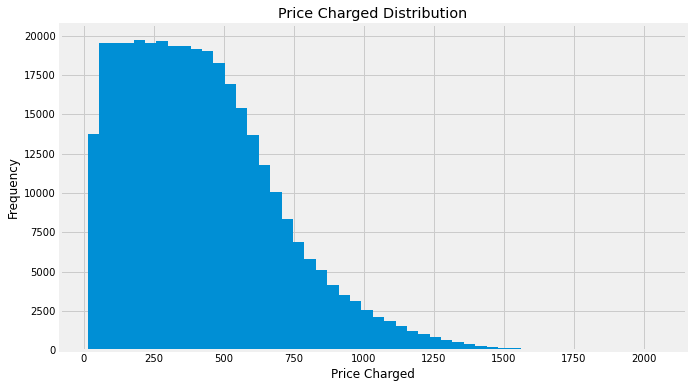

In [159]:
plt.figure(figsize=(10,6))
plt.hist(cab_data['price_charged'], bins=50)
plt.xlabel('Price Charged')
plt.ylabel('Frequency')
plt.title('Price Charged Distribution')
plt.show()

In [ ]:
plt.figure(figsize=(10,6))
plt.hist(cab_data['price_charged'], bins=50)
plt.xlabel('Price Charged')
plt.ylabel('Frequency')
plt.title('Price Charged Distribution')
plt.show()

### Time Series Analysis

We can use statsmodels to perform time series analysis and get a general idea of the data over time.

In [265]:
from statsmodels.tsa import stattools as ts
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_model import ARIMAResults

In [266]:
# Create an univariate time series dataset indexed by the travel date
ts_data = pd.DataFrame(cab_data['trip_cost'], index=cab_data['travel_date'])

# Create a function to determine the autocorrelation of the time series
def autocorrelation(ts_data):
    """
    Method:
        Create a function to determine the autocorrelation of the time series
    """
    # Calculate the autocorrelation of the time series
    acf_data = ts.acf(ts_data)
    # Plot the autocorrelation of the time series
    plt.figure(figsize=(10,6))
    plt.plot(acf_data)
    plt.xlabel('Lag')
    plt.ylabel('Autocorrelation')
    plt.title('Autocorrelation of Trip Cost')
    plt.show()
    return


autocorrelation(ts_data)

In [ ]:
# Create a function to determine the partial autocorrelation of the time series
def partial_autocorrelation(ts_data):
    """
    Method:
        Create a function to determine the partial autocorrelation of the time series
    """
    # Calculate the partial autocorrelation of the time series
    pacf_data = ts.pacf(ts_data)
    # Plot the partial autocorrelation of the time series
    plt.figure(figsize=(10,6))
    plt.plot(pacf_data)
    plt.xlabel('Lag')
    plt.ylabel('Partial Autocorrelation')
    plt.title('Partial Autocorrelation of Trip Cost')
    plt.show()
    return

In [ ]:
# Create a function to determine the ADF test of the time series
def adf_test(ts_data):
    """
    Method:
        Create a function to determine the ADF test of the time series
    """
    # Calculate the ADF test of the time series
    adf_data = adfuller(ts_data)
    # Plot the ADF test of the time series
    plt.figure(figsize=(10,6))
    plt.plot(adf_data)
    plt.xlabel('Lag')
    plt.ylabel('ADF Test')
    plt.title('ADF Test of Trip Cost')
    plt.show()
    return
    

In [ ]:
# Create a function to determine the ARIMA model of the time series
def arima_model(ts_data):
    """
    Method:
        Create a function to determine the ARIMA model of the time series
    """
    # Calculate the ARIMA model of the time series
    arima_data = ARIMA(ts_data, order=(1,1,1)).fit()
    # Plot the ARIMA model of the time series
    plt.figure(figsize=(10,6))
    plt.plot(arima_data.fittedvalues)
    plt.xlabel('Date')
    plt.ylabel('Trip Cost')
    plt.title('ARIMA Model of Trip Cost')
    print(arima_data.summary())
    plt.show()
    return

Areas to investigate:
Which company has maximum cab users at a particular time period?
Does margin proportionally increase with increase in number of customers?
What are the attributes of these customer segments?
Although not required, we encourage you to document the process and findings
What is the business problem?
What are the properties of the data provided (data intake report)
What steps did you take in order to create an applicable data set?
How did you prepare and perform your analysis?
What type of analysis did you perform?
Why did you choose to use certain analytical techniques over others?
What were the results? Prepare a presentation that summarizes your analysis and recommendations and identify which company is performing better and is a better investment opportunity for XYZ.

### Building a G2M Strategy

1. Identify the buying center and personas.
2. Craft a value matrix to help identify messaging.
3. Test your messaging.
4. Optimize your ads based on the results of your tests before implementing them on a wide scale.
5. Understand your buyer’s journey.
6. Choose one (or more) of the four most common sales strategies.
7. Build brand awareness and demand generation with inbound and/or outbound methods.
8. Create content to get inbound leads.
9. Find ways to optimize your pipeline and increase conversion rates.
10. Analyze and shorten the sales cycle.
11. Reduce customer acquisition cost.
12. Strategize ways to tap into your existing customer base.
13. Adjust and iterate as you go.
14. Retain and delight your customers.

As a company owner - Using the G2M strategy the focus will be considereably to that of its Customers/Users. Th

1) Can we tell how much would be earned by quarter, period, year of a specific time period? (Predictive analysis, Time Series)

2) What areas (city) generate greatest profit? (Using population and number of users as a reference)

3) Customer preference over pink and yellow?

4) Average age of user? (if applicable create age bins)

5) Average income of user? (hist, highest income user - states)

6) If company purchases a specific fleet of vehicles what is the time range for ROI? (Apply hypothesis testing and A/B Testing)

7) What are users/consumers using more (cash or card)?

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
ax.hist(cab_data['price_charged'], bins=50)
ax.set_xlabel('Price Charged')
ax.set_ylabel('Frequency')
ax.set_title('Price Charged Distribution')
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(7,5))
ax.scatter(cab_data['travel_date'].dt.month, cab_data['trip_cost'])
ax.set_xlabel('Travel Date', fontsize=12, fontweight='bold', color='black', labelpad=10) 
ax.set_ylabel('Trip Cost', fontsize=12, fontweight='bold', color='black', labelpad=10)
ax.set_title('Travel Date vs Trip Cost', fontsize=14, fontweight='bold', color='black', pad=10)
plt.show()

In [ ]:
price_carried_per_km = (cab_data['price_charged'] / cab_data['km_traveled']) 
plt.figure(figsize=(10,6))
plt.scatter(cab_data['km_traveled'], price_carried_per_km)
plt.xlabel('KM Travelled')
plt.ylabel('Price Charged per KM')
plt.title('Price Charged per KM vs KM Travelled')
plt.show()

In [ ]:
from scipy.stats import pearsonr

list1 = new_df['KM Travelled']
list2 = new_df['Price Change']
new_df, _ = pearsonr(list1, list2)
print('Pearsons correlation: %.3f' % new_df)

### Business Questions
    G2M Strategy 
    
- Market Segmentation
- Product
- Buyer
- Routes to Market
***
**Pitfalls to Avoid** 
- Poor product market fit
- Oversaturation
***
**Methodologies**
- Funnel - Awareness, consideration, and decision stages of the customer’s journey
- Flywheel - Attracting, engaging, and delighting prospects, leads, and customers
***
**Components**
- **Product-Market Fit:** What problem(s) does your product solve?
- **Target Audience:** Who is experiencing the problem that your product solves? How much are they willing to pay for a solution? What are the pain points and frustrations that you can alleviate?
- **Competition and Demand:** Who already offers what you’re launching? Is there a demand for the product, or is the market oversaturated?
- **Distribution:** Through what mediums will you sell the product or service? A website, an app, or a third-party distributor?


In [ ]:
def plot_bar(group, title):
    plt.figure(figsize=(14,6))
    sns.barplot(x=group.index,y=group.values)     
    plt.title(title)
    plt.xticks(rotation=45)
    plt.show()
    print(group)
    
def distribution_graph(dataset, title, x, x_label, color):
    plt.figure(figsize=(14,6))
    ax=sns.histplot(data = dataset, x=x,bins=40, color= color)
    plt.title(title)
    plt.ylabel('Frequency')
    plt.xlabel(x_label)